In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision import transforms, models
import torchvision.utils as vutils
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.animation import PillowWriter
import time

In [3]:
train_data_path = "../../data/shadow_play/input"
# train_data_path = "../../data/shadow_play/label"

LEARNING_RATE = 1e-4
EPOCHS = 100
BATCH_SIZE = 200

In [4]:
alexnet = models.alexnet(pretrained=True)
display(alexnet)

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
    (2): ReLU(inplace)
    (3): Dropout(p

In [5]:
class HandClassifier(nn.Module):
    def __init__(self, output):
        super(HandClassifier, self).__init__()
        
        self.process = nn.Sequential(
            alexnet.features,
            nn.Conv2d(256, output, (7, 7)),
            nn.ReLU(),
            nn.Softmax2d()
        )
        
    def forward(self, inputs):
        return self.process(inputs).squeeze()

In [6]:
transform = transforms.Compose([
    transforms.Resize(300),
    transforms.RandomPerspective(),
    transforms.RandomRotation((-45, 45)),
    transforms.RandomVerticalFlip(),
    transforms.RandomHorizontalFlip(),
    transforms.CenterCrop(256),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [7]:
dataset = torchvision.datasets.ImageFolder(
    root = train_data_path,
    transform = transform
)
loader = torch.utils.data.DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    num_workers=0,
    shuffle=True
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


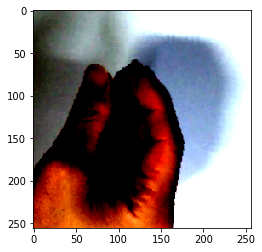

In [8]:
xs, ys = next(iter(loader))

plt.imshow(xs[0].permute(1, 2, 0))

In [9]:
model = HandClassifier(3).cuda()

criteria = F.cross_entropy
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

In [16]:
for epoch in range(EPOCHS):
    loss_sum = torch.tensor(0.)
    print (f'{epoch} epoch')
    for xs, ys in loader:
        output = model(xs.cuda())
        loss = criteria(output, ys.cuda())
        
        loss_sum += loss.detach().item()
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    print ("\t{}".format(loss_sum.mean()))

0 epoch
	1.102109670639038
1 epoch
	1.0891438722610474
2 epoch
	1.0740834474563599
3 epoch
	1.0619401931762695
4 epoch
	1.0707104206085205
5 epoch
	1.0473769903182983
6 epoch
	1.0223076343536377
7 epoch
	1.041347861289978
8 epoch
	1.0208971500396729
9 epoch
	0.9807327389717102
10 epoch
	0.9868394732475281
11 epoch
	0.9349746704101562
12 epoch
	0.9348457455635071
13 epoch
	0.9487699270248413
14 epoch
	0.8736384510993958
15 epoch
	0.8867594003677368
16 epoch
	0.8647820353507996
17 epoch
	0.8646062612533569
18 epoch
	0.7865285277366638
19 epoch
	0.8435447812080383
20 epoch
	0.8146352171897888
21 epoch
	0.791517972946167
22 epoch
	0.791460394859314
23 epoch
	0.7890117168426514
24 epoch
	0.7505513429641724
25 epoch
	0.8048305511474609
26 epoch
	0.8015468716621399
27 epoch
	0.756170928478241
28 epoch
	0.7648224234580994
29 epoch
	0.7692424058914185
30 epoch
	0.7615190148353577
31 epoch
	0.779120922088623
32 epoch
	0.7555364966392517
33 epoch
	0.7586058378219604
34 epoch
	0.7607710361480713
3

In [11]:
torch.save(model.state_dict(), "../../model/shadow_play/model.pth")

NameError: name 'model' is not defined

In [13]:
dd = "../../data/shadow_play/" + "IMG_9606"
transform = transforms.Compose([
    transforms.Resize(512),
    transforms.CenterCrop(512),
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
dataset = torchvision.datasets.ImageFolder(
    root = dd,
    transform = transform
)
loader = torch.utils.data.DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    num_workers=0,
    shuffle=False
)
xs, ys = next(iter(loader))

display(len(xs))

200

In [14]:
output = model(xs.cuda())
vals, idxs = output.max(dim=1)

display(output.shape)
display(idxs.shape)

torch.Size([200, 3])

torch.Size([200])

In [15]:
label_dir = "../../data/shadow_play/label/spongebob2_resize/"
def get_image(root, idx, ext="jpg"):
    return mpimg.imread(root + str(idx) + "." + ext)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

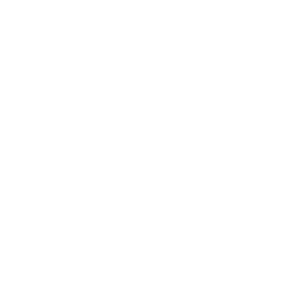

In [16]:
#%%capture
fig = plt.figure(figsize=(10,5))
plt.axis("off")

original = [[plt.imshow(x.permute(1, 2, 0).numpy(), animated=True)] for x in xs.cpu().detach()]
original_ani = animation.ArtistAnimation(fig, original, interval=100, repeat_delay=1000, blit=False)

In [17]:
writer = PillowWriter(fps=20)
original_ani.save("original.gif", writer=writer)

200

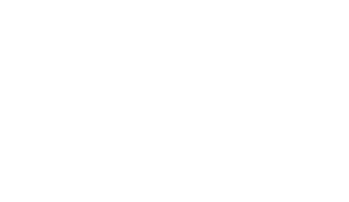

In [18]:
matplotlib.rcParams['animation.embed_limit'] = 2**128

fig = plt.figure(1)
plt.axis("off")

converted = [[plt.imshow(get_image(label_dir, idx+1), animated=True)] for idx in idxs.cpu().detach().numpy()]
converted_ani = animation.ArtistAnimation(fig, converted, interval=100, repeat_delay=1000, blit=False)

display(len(converted))

In [19]:
HTML(original_ani.to_jshtml())

In [20]:
HTML(converted_ani.to_jshtml())

In [31]:
display(idxs.shape)
display(idxs)

torch.Size([200])

tensor([2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
        0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0,
        1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0,
        0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
        2, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')

In [21]:

writer = PillowWriter(fps=20)
converted_ani.save("converted.gif", writer=writer)

In [12]:
module_path = "../../model/shadow_play/model.pth"
model = HandClassifier(3).cuda()
model.load_state_dict(torch.load(module_path))
model.eval()


HandClassifier(
  (process): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
      (1): ReLU(inplace)
      (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
      (4): ReLU(inplace)
      (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
      (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (7): ReLU(inplace)
      (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (9): ReLU(inplace)
      (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace)
      (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): Conv2d(256, 3, kernel_size=(7, 7), stride=(1, 1))
    (2): ReLU()
    (3): Softmax2d()
  )
)